Key Points:

To be plotted a (multi)polygon must be in form: geopandas.geodataframe.GeoDataFrame

To run 'intersects' it must be a str representing a geojson geometry

To display on leaflet map must be a dict representing a geojson geometry

To use as mask for xarray 'clip' it must be a list (of coordinates)

In [28]:
#!pip install rioxarray
import dask.array as da
import pystac_client
from pystac_client import Client
import leafmap
from datetime import datetime
import dask
import planetary_computer as pc
import leafmap
import geogif
import numpy as np
import xarray as xr
import rioxarray
import geopandas as gpd
import matplotlib.pyplot as plt
import geojson
import json
from geogif import dgif, gif
import pandas as pd
import shapely
from shapely.geometry import mapping
from shapely.geometry import box
import folium
from pystac import ItemCollection
import numpy as np
import rasterio
from rasterio.transform import Affine
from rasterio.crs import CRS

In [2]:
#!pip install stackstac==0.5.0 --upgrade 

In [2]:
# stackstac needs to be 0.5.0
# if it is not run !pip install stackstac==0.5.0 --upgrade  
# And restart kernal
# or maybe this works? "conda install -c conda-forge stackstac" in MPC terminal and then restart this kernal
import stackstac
stackstac.__version__

'0.5.0'

In [3]:
boundary = gpd.read_file('Boundary/WorcesterBoundary.shp')

print(boundary.crs)
print(type(boundary))

EPSG:3585
<class 'geopandas.geodataframe.GeoDataFrame'>


In [4]:
# To be used by the intersect function we have to convert the boundary polygon into a string representing a geojson
boundary4326=boundary.to_crs(4326)
boundary_json = boundary4326.to_json()
boundary_geo = geojson.loads(boundary_json)["features"][0]["geometry"]
boundary_geojson = json.dumps(boundary_geo)
# finally this can be used by the intersect function
SA= boundary_geojson
print(type(SA))
# print(SA)

<class 'str'>


In [5]:
# the stackstac 'bounds_latlon' can only take a rectangle (i think)
# Represented as a list (tuple) of 4 coordinates 
# So we will get the envelope of the city limits
# An in geospatial terms am 'envelope" is the smallest possible rectangle that can contain a given shape

SA_envelope = boundary4326.envelope
print(SA_envelope.crs)
print(SA_envelope)
print(type(SA_envelope))

EPSG:4326
0    POLYGON ((-71.88410 42.20998, -71.73118 42.209...
dtype: geometry
<class 'geopandas.geoseries.GeoSeries'>


In [6]:
# Meanwhile, to visualize our SA in folium, the study area needs to be converted to a dictionary representing a geojson

# create a json version of the envelope
envelope_json = SA_envelope .to_json()

# extract the geometry alone into its own variable
envelope_geo = json.loads(envelope_json)['features'][0]['geometry']
#This can now be used by folium
print(type(envelope_geo))

<class 'dict'>


In [7]:
from dask.distributed import Client, LocalCluster
cluster = LocalCluster()
client = Client(cluster)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /user/jaandrews@clarku.edu/proxy/8787/status,
Dashboard: /user/jaandrews@clarku.edu/proxy/8787/status,Workers: 4
Total threads: 4,Total memory: 32.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41473,Workers: 4
Dashboard: /user/jaandrews@clarku.edu/proxy/8787/status,Total threads: 4
Started: Just now,Total memory: 32.00 GiB
Comm: tcp://127.0.0.1:44311,Total threads: 1
Dashboard: /user/jaandrews@clarku.edu/proxy/37217/status,Memory: 8.00 GiB
Nanny: tcp://127.0.0.1:34959,


In [8]:
api_url = "https://planetarycomputer.microsoft.com/api/stac/v1"
start_date = datetime(2007, 1, 1).isoformat()
end_date = datetime(2023, 12, 31).isoformat()

In [9]:
from pystac_client import Client

client = Client.open(api_url)
collections = client.get_collections()
search = client.search(
    datetime=f"{start_date}/{end_date}",
    collections=["landsat-c2-l2"],
    intersects=SA,
    query=["eo:cloud_cover<25"],
    sortby=["-properties.datetime"],
    max_items=1000,
)

In [10]:
%time
items = pc.sign(search)
len(items)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 9.54 µs


730

In [11]:
# Display the study area and Landsat vs Sentinel swaths
# This takes a while to run and is not really necessary
m = folium.Map(location=[42.30013, -71.78474],
               zoom_start=7, 
               #height=800
              )

folium.GeoJson(
    envelope_geo,
    name=f"bbox",
    style_function=lambda feature: {'color': 'green', 'weight': 2, 'fillColor': 'green'},
    tooltip=f"bbox"
).add_to(m)

folium.GeoJson(
    boundary_geo,
    name=f"Study Area",
    style_function=lambda feature: {'color': 'red', 'weight': 2, 'fillColor': 'red'},
    tooltip=f"Study Area"
).add_to(m)

folium.GeoJson(
    items.to_dict(),
    name=f"Landsat swaths",
    style_function=lambda feature: {'color': 'blue', 'weight': 2, 'fillColor': 'transparent'},
    #tooltip=f"Study Area"
).add_to(m)

# Add Layer Control
folium.LayerControl().add_to(m)

m

In [12]:
# Now we will convert SA_envelope into a tuple to be used by stackstac.stack

# Get the bounding box of the envelope geometry
minx, miny, maxx, maxy = SA_envelope.total_bounds

# Create the envelope variable with the bounding box coordinates
envelope_bounds = (minx, miny, maxx, maxy)
print(envelope_bounds)
print(type(envelope_bounds))

(-71.88410209880635, 42.209978029087196, -71.73118096982417, 42.341178939360375)
<class 'tuple'>


In [13]:
# Initialize image stack
stack = stackstac.stack(items, bounds_latlon=envelope_bounds, epsg=32619)
stack
stack.band

<xarray.DataArray 'band' (band: 22)> Size: 1kB
array(['qa', 'red', 'blue', 'drad', 'emis', 'emsd', 'lwir', 'trad', 'urad',
       'atran', 'cdist', 'green', 'nir08', 'swir16', 'swir22', 'cloud_qa',
       'qa_pixel', 'qa_radsat', 'atmos_opacity', 'lwir11', 'coastal',
       'qa_aerosol'], dtype='<U13')
Coordinates: (12/13)
  * band                       (band) <U13 1kB 'qa' 'red' ... 'qa_aerosol'
    landsat:correction         <U4 16B 'L2SP'
    landsat:wrs_type           <U1 4B '2'
    gsd                        (band) object 176B None None None ... None None
    landsat:collection_number  <U2 8B '02'
    description                (band) object 176B 'Collection 2 Level-2 Quali...
    ...                         ...
    title                      (band) object 176B 'Surface Temperature Qualit...
    classification:bitfields   (band) object 176B None ... [{'name': 'fill', ...
    common_name                (band) object 176B None None ... 'coastal' None
    center_wavelength          (band) object 176B None None None ... 0.44 None
    full_width_half_max        (band) object 176B None None None ... 0.02 None
    epsg                       int64 8B 32619

In [14]:
# Make a bitmask---when we bitwise-and it with the data, it leaves just the 4 bits we care about
mask_bitfields = [1, 2, 3, 4]  # dilated cloud, cirrus, cloud, cloud shadow
bitmask = 0
for field in mask_bitfields:
    bitmask |= 1 << field

bin(bitmask)

qa = stack.sel(band="qa_pixel").astype("uint16")
bad = qa & bitmask  # just look at those 4 bits

filtered = stack.where(bad == 0)  # mask pixels where any one of those bits are set

# Check the typical interval between scenes?
#good.time.diff("time").dt.days.plot.hist();

# vis
filtered

<xarray.DataArray 'stackstac-c5f79053b1f31592c8e64fc5496eb3e9' (time: 730,
                                                                band: 22,
                                                                y: 500, x: 438)> Size: 28GB
dask.array<where, shape=(730, 22, 500, 438), dtype=float64, chunksize=(1, 1, 500, 438), chunktype=numpy.ndarray>
Coordinates: (12/23)
  * time                         (time) datetime64[ns] 6kB 2007-01-02T15:17:1...
    id                           (time) <U31 91kB 'LE07_L2SP_012031_20070102_...
  * band                         (band) <U13 1kB 'qa' 'red' ... 'qa_aerosol'
  * x                            (x) float64 4kB 2.619e+05 ... 2.75e+05
  * y                            (y) float64 4kB 4.692e+06 ... 4.677e+06
    platform                     (time) <U9 26kB 'landsat-7' ... 'landsat-9'
    ...                           ...
    landsat:collection_category  (time) <U2 6kB 'T1' 'T1' 'T1' ... 'T1' 'T1'
    proj:epsg                    (time) int64 6kB 32619 32618 ... 32618 32619
    view:off_nadir               (time) object 6kB 0 0 0 0 0 0 0 ... 0 0 0 0 0 0
    sci:doi                      (time) <U16 47kB '10.5066/P9C7I13B' ... '10....
    landsat:wrs_row              (time) <U3 9kB '031' '031' ... '031' '031'
    epsg                         int64 8B 32619
Attributes:
    spec:        RasterSpec(epsg=32619, bounds=(261900.0, 4676700.0, 275040.0...
    crs:         epsg:32619
    transform:   | 30.00, 0.00, 261900.00|\n| 0.00,-30.00, 4691700.00|\n| 0.0...
    resolution:  30.0

In [15]:
# # Check that images seem to be ordered properly
# time_values = filtered.time.values
# print("Time values:")
# print(time_values[:1000])


In [16]:
filtered_sorted = filtered.sortby('time')
filtered_sorted = filtered_sorted[:-1]
# filtered_sorted
filtered_sorted.band

<xarray.DataArray 'band' (band: 22)> Size: 1kB
array(['qa', 'red', 'blue', 'drad', 'emis', 'emsd', 'lwir', 'trad', 'urad',
       'atran', 'cdist', 'green', 'nir08', 'swir16', 'swir22', 'cloud_qa',
       'qa_pixel', 'qa_radsat', 'atmos_opacity', 'lwir11', 'coastal',
       'qa_aerosol'], dtype='<U13')
Coordinates:
  * band                       (band) <U13 1kB 'qa' 'red' ... 'qa_aerosol'
    landsat:correction         <U4 16B 'L2SP'
    landsat:wrs_type           <U1 4B '2'
    landsat:collection_number  <U2 8B '02'
    epsg                       int64 8B 32619

In [17]:
bands=filtered_sorted.sel(band=["nir08", "swir16", "red","green","blue", 'lwir'])
print(bands)

<xarray.DataArray 'stackstac-c5f79053b1f31592c8e64fc5496eb3e9' (time: 729,
                                                                band: 6,
                                                                y: 500, x: 438)> Size: 8GB
dask.array<getitem, shape=(729, 6, 500, 438), dtype=float64, chunksize=(1, 1, 500, 438), chunktype=numpy.ndarray>
Coordinates: (12/23)
  * time                         (time) datetime64[ns] 6kB 2007-01-02T15:17:1...
    id                           (time) <U31 90kB 'LE07_L2SP_012031_20070102_...
  * band                         (band) <U13 312B 'nir08' 'swir16' ... 'lwir'
  * x                            (x) float64 4kB 2.619e+05 ... 2.75e+05
  * y                            (y) float64 4kB 4.692e+06 ... 4.677e+06
    platform                     (time) <U9 26kB 'landsat-7' ... 'landsat-8'
    ...                           ...
    landsat:collection_category  (time) <U2 6kB 'T1' 'T1' 'T1' ... 'T1' 'T1'
    proj:epsg                    (time) int64 6kB

In [69]:
# Compute the median along the time dimension
# We now have 17 images of 6 bands, each a yearly median
yearlyMedian = bands.resample(time="Y").median("time", keep_attrs=True)
print(yearlyMedian)


<xarray.DataArray 'stackstac-c5f79053b1f31592c8e64fc5496eb3e9' (time: 17,
                                                                band: 6,
                                                                y: 500, x: 438)> Size: 179MB
dask.array<stack, shape=(17, 6, 500, 438), dtype=float64, chunksize=(1, 1, 500, 438), chunktype=numpy.ndarray>
Coordinates:
  * band                       (band) <U13 312B 'nir08' 'swir16' ... 'lwir'
  * x                          (x) float64 4kB 2.619e+05 2.619e+05 ... 2.75e+05
  * y                          (y) float64 4kB 4.692e+06 4.692e+06 ... 4.677e+06
    landsat:correction         <U4 16B 'L2SP'
    landsat:wrs_type           <U1 4B '2'
    landsat:collection_number  <U2 8B '02'
    epsg                       int64 8B 32619
  * time                       (time) datetime64[ns] 136B 2007-12-31 ... 2023...
Attributes:
    spec:        RasterSpec(epsg=32619, bounds=(261900.0, 4676700.0, 275040.0...
    crs:         epsg:32619
    transform:   | 3

In [19]:
print(type(boundary_geo))
#print(boundary_geo.crs)

<class 'geojson.geometry.Polygon'>


In [70]:
# Clip median yearly image to city boundary
# Start by making it into a geodataframe, match crs to xarray images
geometry_gdf = gpd.GeoDataFrame(geometry=[boundary_geo], crs='epsg:4326')
geometry_gdf = geometry_gdf.to_crs('epsg:32619')
#geometry_gdf = gpd.GeoDataFrame(geometry=[geometry_part], crs='epsg:32617')

# Now extract the geometry from the GeoDataFrame
geometry_gdf_corrected = geometry_gdf['geometry'].iloc[0]

# This line, which I don't fully understand, converts the datatype into a tuple
geometry_tuple = [(geometry_gdf_corrected, 1)]

# Now you can use good.rio.clip() with geometry_part_crs_corrected
clipped = yearlyMedian.rio.clip(geometry_tuple)
clipped


<xarray.DataArray 'stackstac-c5f79053b1f31592c8e64fc5496eb3e9' (time: 17,
                                                                band: 6,
                                                                y: 484, x: 416)> Size: 164MB
dask.array<getitem, shape=(17, 6, 484, 416), dtype=float64, chunksize=(1, 1, 484, 416), chunktype=numpy.ndarray>
Coordinates:
  * band                       (band) <U13 312B 'nir08' 'swir16' ... 'lwir'
  * x                          (x) float64 3kB 2.622e+05 2.622e+05 ... 2.746e+05
  * y                          (y) float64 4kB 4.691e+06 4.691e+06 ... 4.677e+06
    landsat:correction         <U4 16B 'L2SP'
    landsat:wrs_type           <U1 4B '2'
    landsat:collection_number  <U2 8B '02'
    epsg                       int64 8B 32619
  * time                       (time) datetime64[ns] 136B 2007-12-31 ... 2023...
    spatial_ref                int64 8B 0
Attributes:
    spec:        RasterSpec(epsg=32619, bounds=(261900.0, 4676700.0, 275040.0...
    resolution:  30.0

In [40]:
# # Alternate script to calculate indices for one year at a time
# year_of_interest = 2020  # Change this to the desired year

# # Select the data for the specified year
# clipped_year = clipped.sel(time=str(year_of_interest))
# # define bands as variables
# blue = clipped_year.sel(band="blue")
# green = clipped_year.sel(band="green")
# nir = clipped_year.sel(band="nir08")
# swir = clipped_year.sel(band="swir16")
# red = clipped_year.sel(band='red')
# LST1 = clipped_year.sel(band='lwir')
# LST2 = clipped_year.sel(band = 'lwir11')

# # Calculate indices

# # NDBI
# NDBI = (swir-nir)/((swir+nir)+0.00001)

# #EVI
# EVI = 2.5 * ((nir - red) / ((nir + 6 * red - 7.5 * blue + 1)+0.00001))

# # NDVI
# NDVI = (nir-red)/((nir+red)+ 0.00001)

# # UVI
# UVI = (nir - red) / ((nir + red + blue) + 0.00001)


In [23]:
# # This function does not run

# # Now lets remove water pixels from the scene(s)
# # start by creating a calculation for ndwi

# def calculate_ndwi(clipped):
#     # Define bands as variables
#     green = clipped.sel(band="green")
#     nir = clipped.sel(band="nir08")
    
#     # Calculate NDWI
#     NDWI = (green - nir) / ((green + nir) + 0.00001)
    
#     return NDWI

# #and visualize pixels beyond this threshold

# def visualize_ndwi(NDWI):
#     # Visualize NDWI image
#     plt.figure(figsize=(10, 10))
#     plt.imshow(NDWI.squeeze(), cmap='RdYlBu_r')
#     plt.colorbar(label='NDWI')
#     plt.title('Normalized Difference Water Index')
#     plt.xlabel('X')
#     plt.ylabel('Y')
#     plt.show()


In [ ]:
# # Call the NDWI functions
# # Calculate NDWI
# NDWI = calculate_ndwi(clipped)
    
# # Visualize NDWI
# visualize_ndwi(NDWI)

In [71]:
# if the threshold visualized above looks about right, use the same threshold in filter function:
def filter_water(clipped):
    # Define bands as variables
    green = clipped.sel(band="green")
    nir = clipped.sel(band="nir08")
    
    # Calculate NDWI
    NDWI = (green - nir) / ((green + nir) + 0.00001)
    
    # Define a threshold to identify water pixels
    water_threshold = 0.07  # Adjust this threshold as needed
    
    # Mask out water pixels
    clipped_filtered = clipped.where(NDWI < water_threshold)
    
    return clipped_filtered

In [72]:
clipped_filtered = filter_water(clipped)
clipped_filtered

<xarray.DataArray 'stackstac-c5f79053b1f31592c8e64fc5496eb3e9' (time: 17,
                                                                band: 6,
                                                                y: 484, x: 416)> Size: 164MB
dask.array<where, shape=(17, 6, 484, 416), dtype=float64, chunksize=(1, 1, 484, 416), chunktype=numpy.ndarray>
Coordinates:
  * band                       (band) <U13 312B 'nir08' 'swir16' ... 'lwir'
  * x                          (x) float64 3kB 2.622e+05 2.622e+05 ... 2.746e+05
  * y                          (y) float64 4kB 4.691e+06 4.691e+06 ... 4.677e+06
    landsat:correction         <U4 16B 'L2SP'
    landsat:wrs_type           <U1 4B '2'
    landsat:collection_number  <U2 8B '02'
    epsg                       int64 8B 32619
  * time                       (time) datetime64[ns] 136B 2007-12-31 ... 2023...
    spatial_ref                int64 8B 0
Attributes:
    spec:        RasterSpec(epsg=32619, bounds=(261900.0, 4676700.0, 275040.0...
    resolution:  30.0

In [73]:
# Pulling out individual bands
swir = clipped_filtered.sel(band='swir16')
nir = clipped_filtered.sel(band='nir08')
red = clipped_filtered.sel(band='red')
green = clipped_filtered.sel(band='green')
blue = clipped_filtered.sel(band='blue')
LST1 = clipped_filtered.sel (band = 'lwir')
#LST2 = median.sel (band = 'lwir11')

# Lets get a few veg indexes while we're at it
# Normalized Difference Built-up Index:
NDBI = (swir-nir)/((swir+nir)+0.00001)
# enhanced vegetation index:
EVI = 2.5 * ((nir - red) / ((nir + 6 * red - 7.5 * blue + 1)+0.00001))
# urban vegetation index:
UVI = (nir - red) / ((nir + red + blue) + 0.00001)
NDVI = (nir - red)/ (nir + red)

In [82]:
import numpy as np
import rasterio
from rasterio.transform import Affine
from rasterio.crs import CRS

def save_index_for_years(index_data, index_name, years_of_interest):
    # Loop through the years of interest
    for year in years_of_interest:
        # Select the data for the specified year
        index_year = index_data.sel(time=str(year))

        #index_year = index_year.rio.reproject('EPSG:4326')
        data_array = index_year.values.squeeze()  # Remove any unnecessary dimensions

        # Ensure the data array has the correct shape
        _3d = np.expand_dims(data_array, axis=-1) 
        
        # Define the transformation for saving
        transform = Affine.translation(index_year.x.values[0], index_year.y.values[0]) * Affine.scale(index_year.x.values[1] - index_year.x.values[0], index_year.y.values[1] - index_year.y.values[0])


        # Define the profile for saving
        profile = {
            'driver': 'GTiff',
            'height': index_year.sizes['y'],
            'width': index_year.sizes['x'],
            'count': 1,  # For single-band images, count is 1
            'dtype': 'float64',
            'crs': 'EPSG:32619',  # Change CRS to EPSG:4326
            'transform': transform,
        }

        # Check images are in proper format. Should be height, width, band
        # Print(f"Shape of data array for year {year}: {_3d.shape}")

        # Save the image as a TIFF file
        with rasterio.open(f'{index_name}_{year}.tif', 'w', **profile) as dst:
            rolled_3d = np.rollaxis(_3d, axis=2)  # Roll axis 2 to 0th position
            dst.write(rolled_3d)

In [ ]:
# Call the save function to get a tif file for each year and index specified
# Annoyingly you have to change both index_data and index_name variables
index_data = NDBI  # Assuming 'NDBI' is already calculated
index_name = 'NDBI'   # or 'EVI', 'UVI'
years_of_interest = [2007, 2011, 2015, 2019, 2023]

save_index_for_years(index_data, index_name, years_of_interest)

Shape of data array for year 2007: (484, 416, 1)
Shape of data array for year 2011: (484, 416, 1)
Shape of data array for year 2015: (484, 416, 1)
Shape of data array for year 2019: (484, 416, 1)


## Function to visualize images

In [84]:
# This function calls plots the median index image for each year of interest
# And shows range and average of values

import numpy as np

def plot_index_for_years(clipped, index_name):
    
    # Define the years of interest
    years_of_interest = [2007, 2011, 2015, 2019, 2023]
    
    # Loop through the years and plot the index for each year
    for year in years_of_interest:
        # Select the data for the specified year
        clipped_year = clipped_filtered.sel(time=str(year))
        
        # Define bands as variables
        blue = clipped_year.sel(band="blue")
        green = clipped_year.sel(band="green")
        nir = clipped_year.sel(band="nir08")
        swir = clipped_year.sel(band="swir16")
        red = clipped_year.sel(band='red')
        LST1 = clipped_year.sel(band='lwir')

        # Calculate the specified index
        if index_name == 'NDBI':
            index = (swir - nir) / ((swir + nir) + 0.00001)
            cmap='RdYlBu_r'
        elif index_name == 'EVI':
            index = 2.5 * ((nir - red) / ((nir + 6 * red - 7.5 * blue + 1) + 0.00001))
            cmap='RdYlBu'
        elif index_name == 'NDVI':
            index = (nir - red) / ((nir + red) + 0.00001)
            cmap='RdYlBu'
        elif index_name == 'UVI':
            index = (nir - red) / ((nir + red + blue) + 0.00001)
            cmap='RdYlBu'
        elif index_name == 'LST1':
            cmap='RdYlBu_r'
            index = LST1
        else:
            print("Invalid index name. Please choose from 'NDBI', 'EVI', 'NDVI', 'UVI', or 'LST1'.")
            return

        # Print the range of index values for the year
        range_text = f"Range: {index.min().values:.2f} to {index.max().values:.2f}"
        
        # Calculate the average index value for the entire year's scene
        average_index = index.mean().values
        average_text = f"Average: {average_index:.2f}"
        
        # Plotting
        plt.figure(figsize=(15, 15))
        plt.imshow(index.squeeze(), cmap)
        plt.colorbar(label=index_name)
        plt.title('{} (Year: {})'.format(index_name, year))
        plt.xlabel('X')
        plt.ylabel('Y')
        
        # Add text for range and average values
        plt.text(0.05, 0.95, range_text, transform=plt.gca().transAxes, fontsize=8, color='black')
        plt.text(0.05, 0.90, average_text, transform=plt.gca().transAxes, fontsize=8, color='black')
        
        # Save the figure as a TIFF file using xarray
        #plt.savefig(f'{index_name}_{year}.tif')
        
        # Show the plot
        plt.show()


/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)
/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


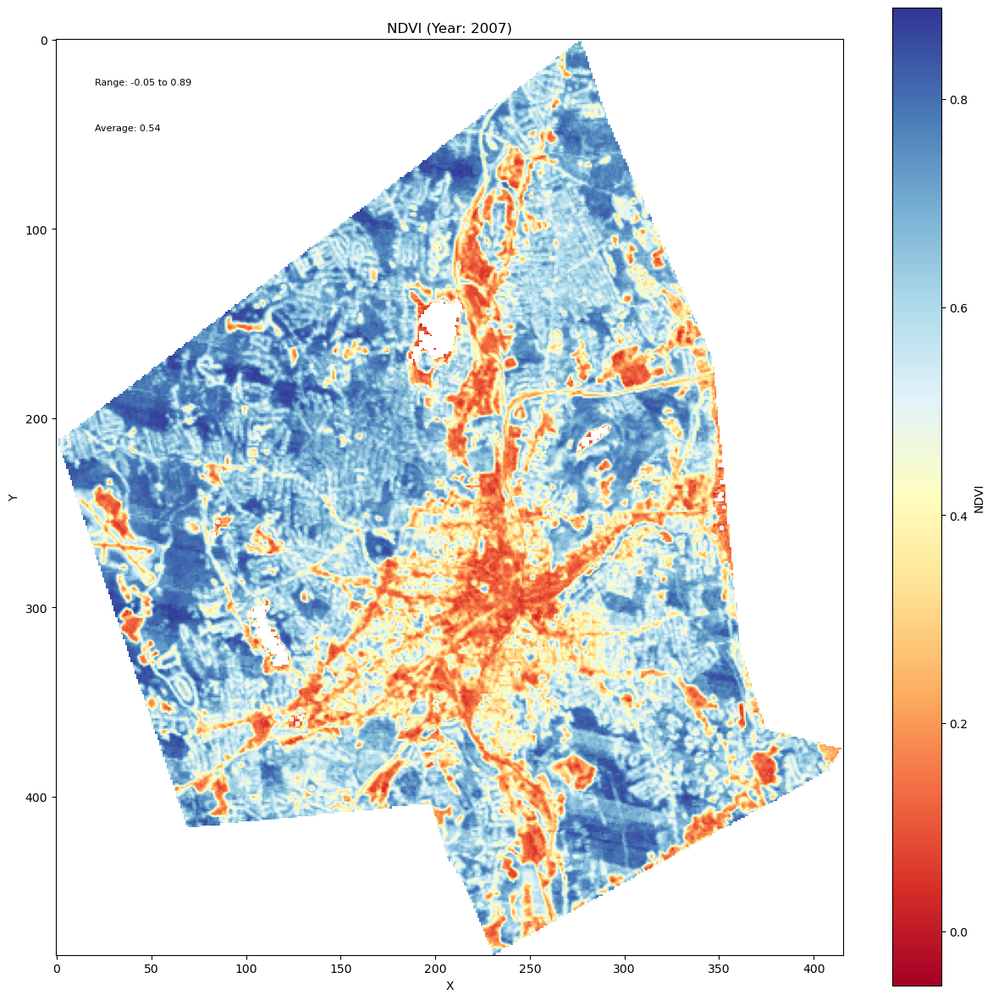

/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


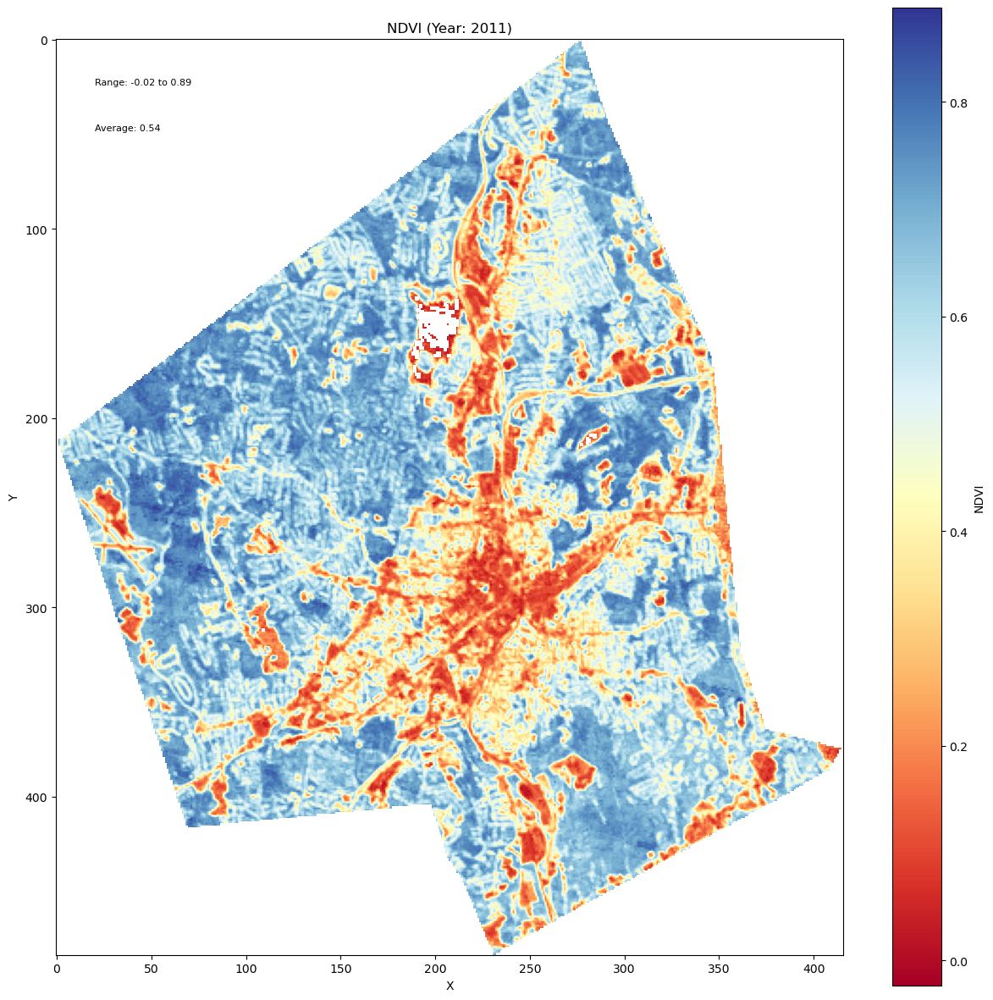

/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)
/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


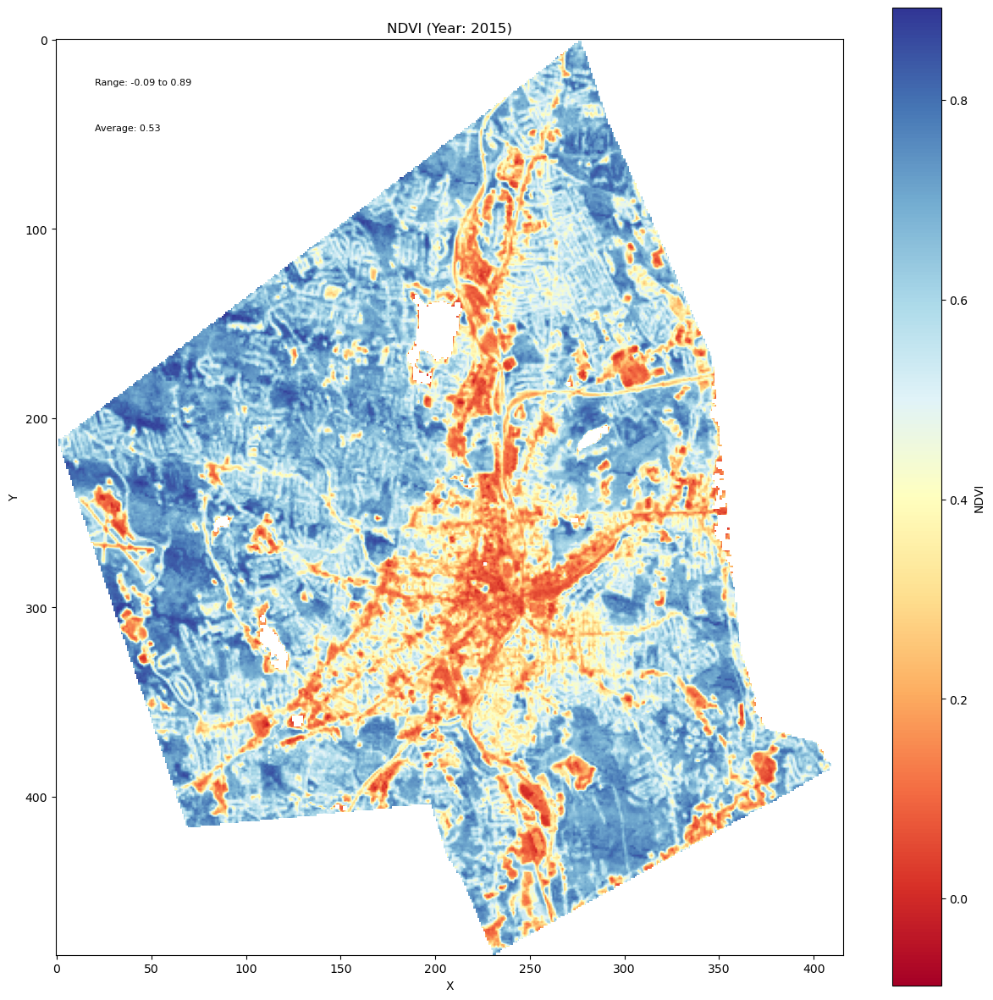

/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)
/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


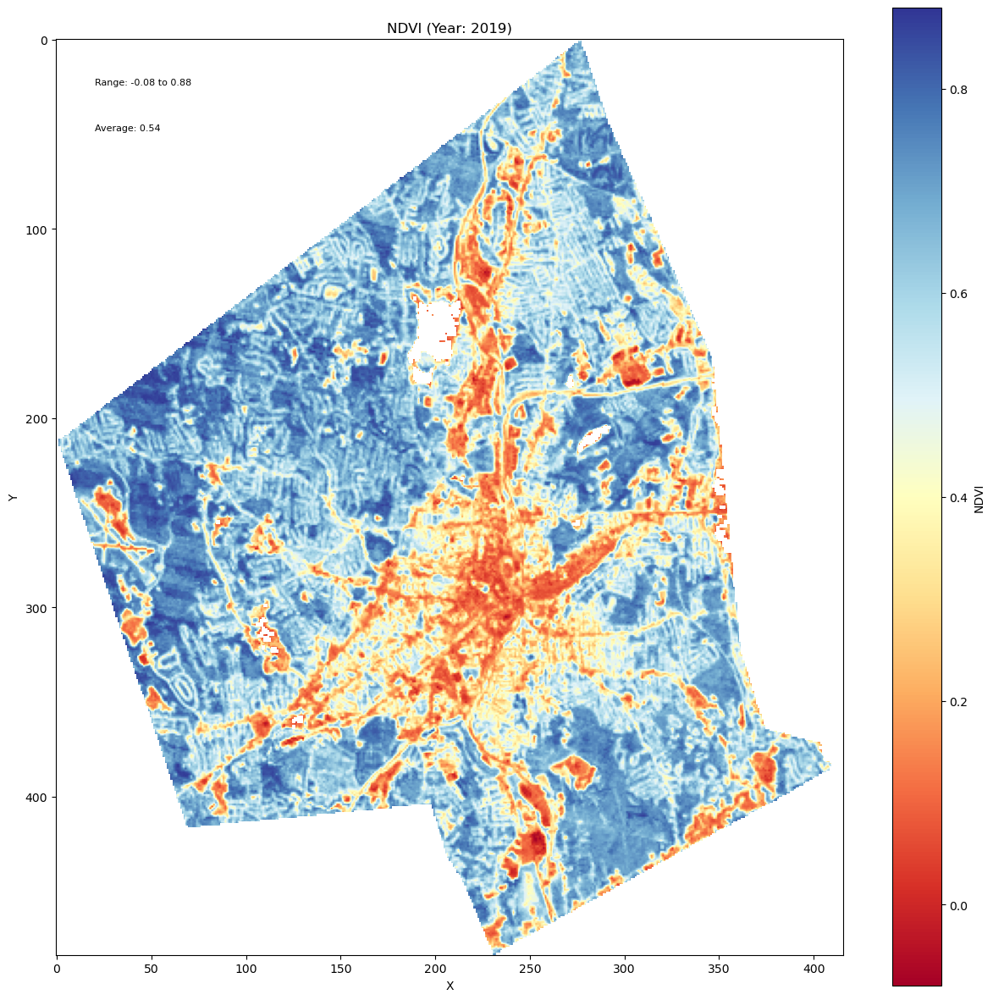

/srv/conda/envs/notebook/lib/python3.11/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


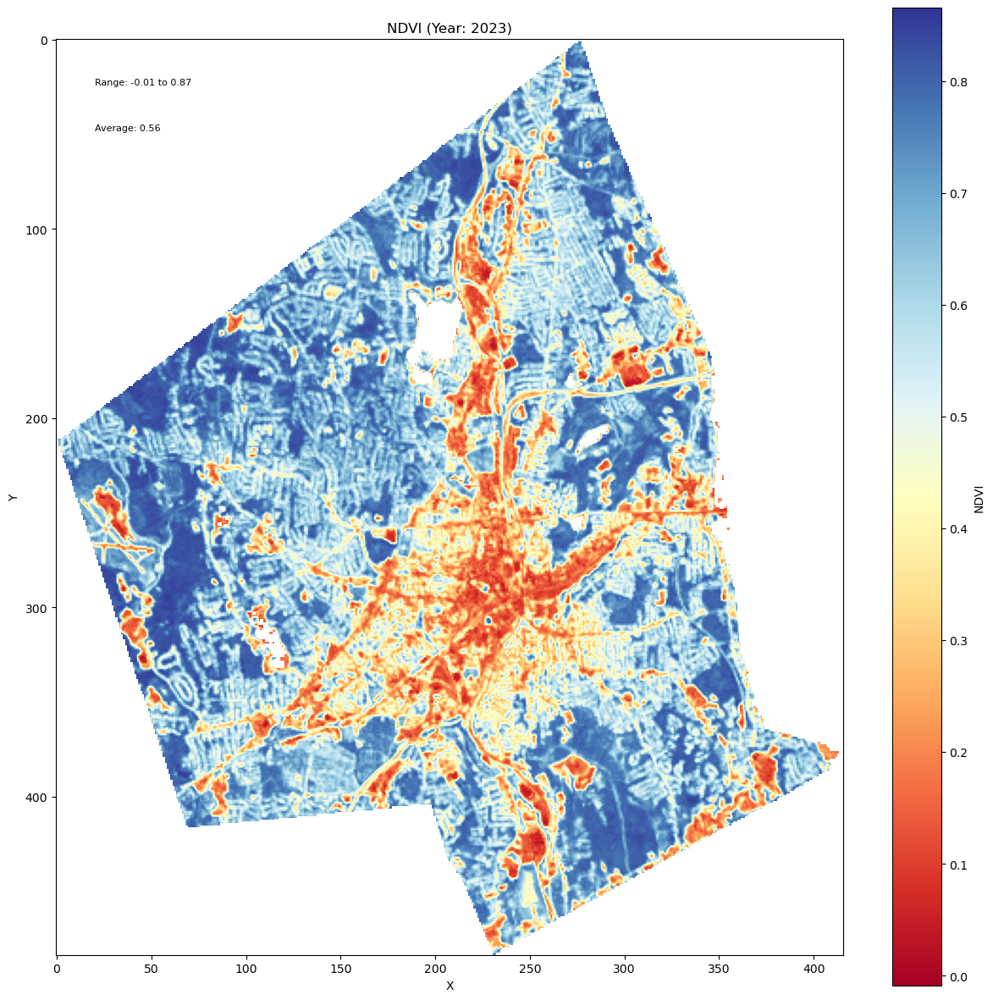

In [85]:
# Call plot function
index_name = 'NDVI'
plot_index_for_years(clipped, index_name)

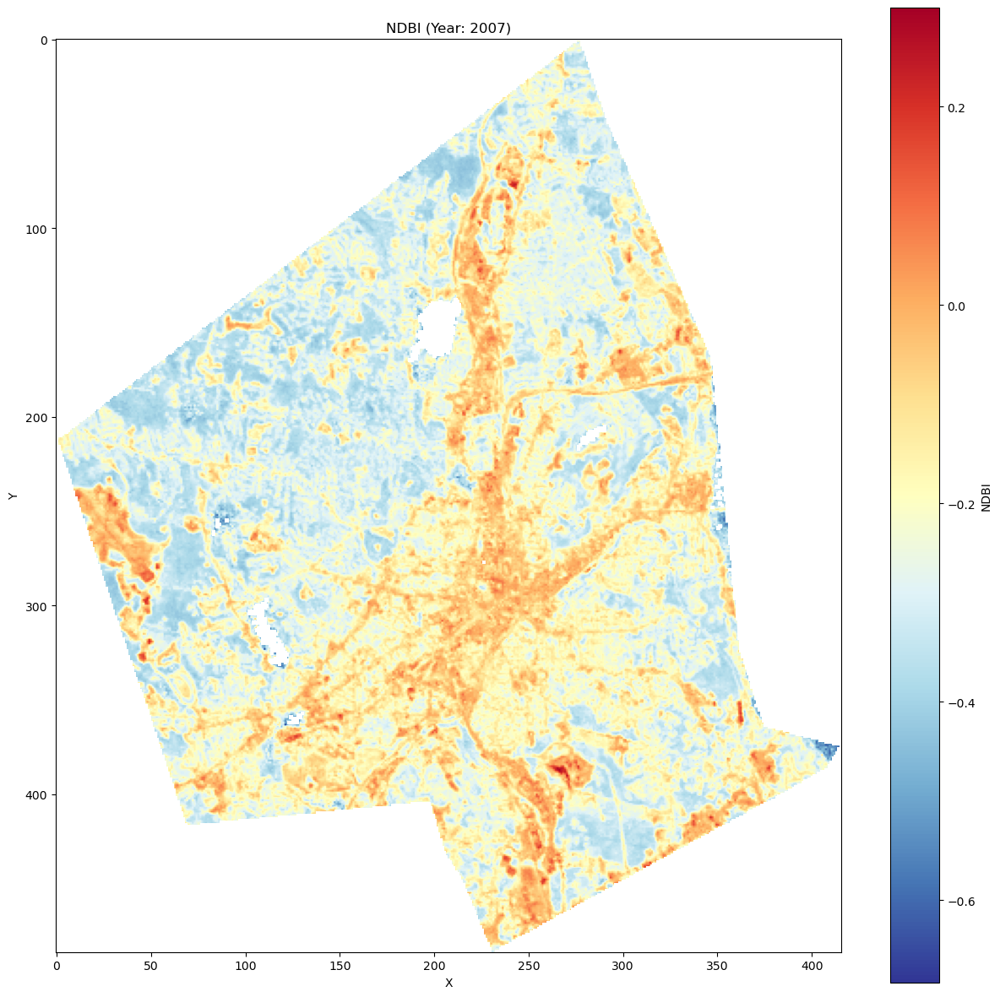

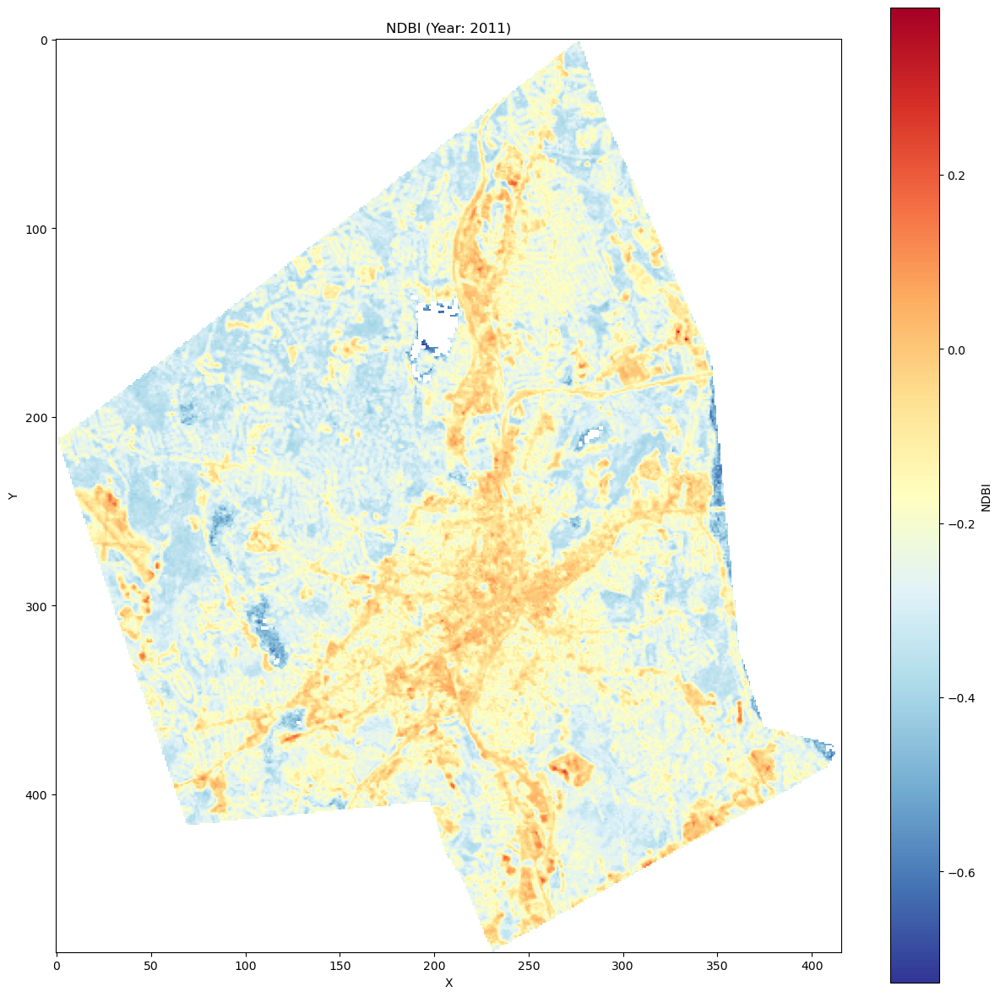

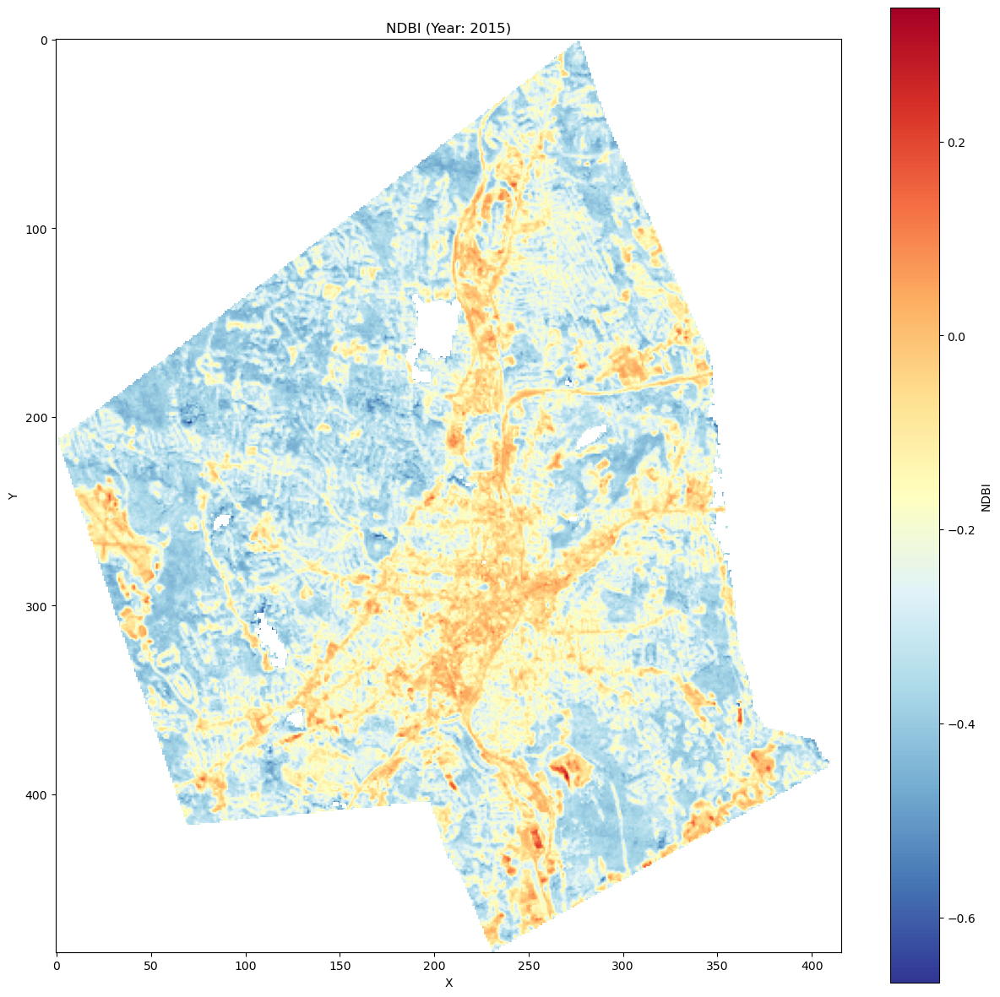

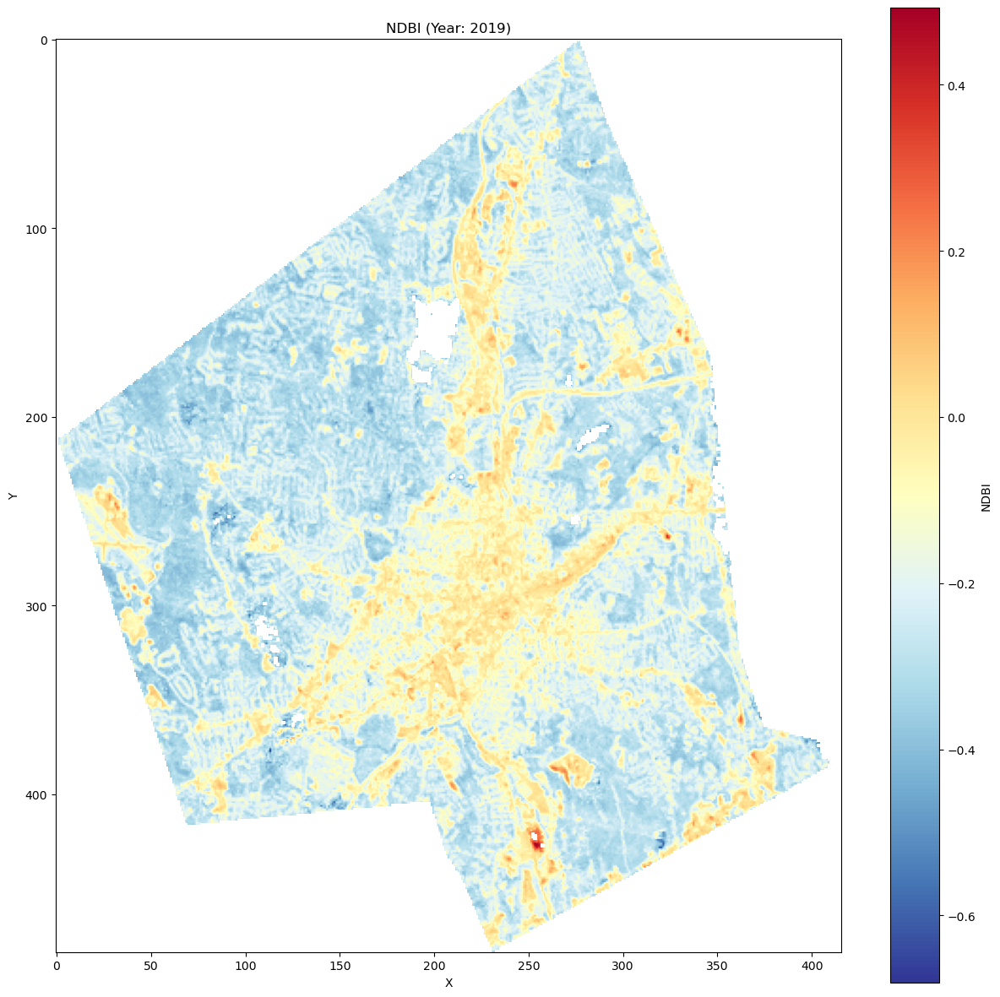

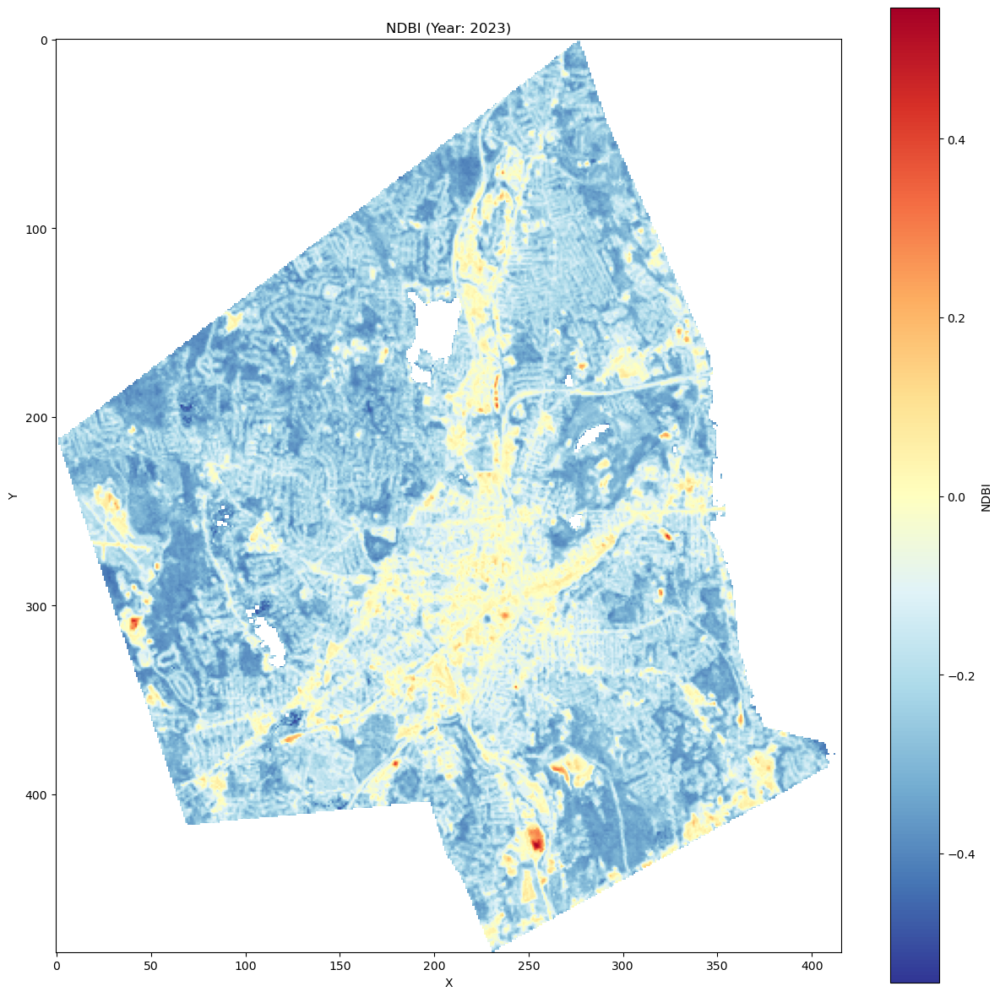

In [37]:
# Call it for another index
index_name = 'NDBI'
plot_index_for_years(clipped, index_name)